# Cognition Academy of the Max Planck School of Cognition

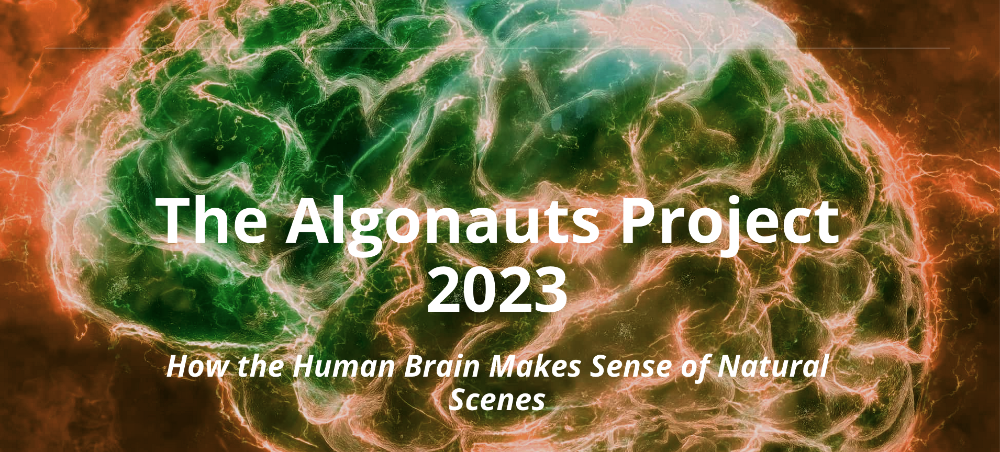

# Tutorial Notebook 1: Exploring the Algonauts Challenge 2023
---
---

## What is the Algonauts Project?
The [Algonauts Project](https://arxiv.org/abs/2301.03198), first launched in 2019, is on a mission to bring biological and machine intelligence researchers together on a common platform to exchange ideas and pioneer the intelligence frontier.

http://algonauts.csail.mit.edu/

There have been 4 challenges already:
1. Algonauts 2019 http://algonauts.csail.mit.edu/2019/
2. Algonauts 2021 http://algonauts.csail.mit.edu/2021/
3. Algonauts 2023 http://algonauts.csail.mit.edu/
4. Algonauts 2025 (coming up)

Each of these challenges has a different focus, while all have the common theme of the **prediction of neural responses** in the human brain using AI models. These hackathon-like competitions create an environment for sharing and open collaboration. With every challenge, it calls for participation with monetary rewards and an invitation to co-author papers with the Algonauts organizers.

---

## What is this notebook about?

This notebook replicates a minimized version of the Algonauts 2023 challenge.

In short, the challenge is based on the Natural Scenes Dataset (NSD), a massive dataset of 7T fMRI responses to images of natural scenes coming from the COCO dataset. The idea of the challenge is to develop encoding models which predict (i.e., encode) the fMRI responses of the brain to the visual input.

This notebook will cover the following steps:

0. Configuration - Downloading necessary data
1. Downloading the dataset
2. Getting to know the data before playing with it
  - Visualizing the distinct regions across the brain
  - Visualizing some example images
  - Visualizing fMRI responses to NSD images in specific regions
3. Example Study: Predictive capabilities of Deep Neural Networks Models for the Visual Cortex using Linear Encoding on **ResNet50**
4. Automating the example study for **multiple models and ROIs**


---
---

# 0 | Configuration
Execute the cell below to install all necessary dependencies

In [ ]:
!pip install -U git+https://github.com/cvai-roig-lab/Net2Brain@development
!pip install nilearn==0.9.2

**Restart the runtime before continuing**

Execute the following cell for imports and helper functions


 ## 0.1 | **Execute hidden cell below for all imports and helpter functions**

In [1]:
import os
import random
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pprint import pprint
from ipywidgets import interact, interact_manual, widgets
from IPython.display import display
from nilearn import datasets, plotting
from net2brain.feature_extraction import FeatureExtractor
from net2brain.taxonomy import print_netset_models
from ipywidgets import VBox



############################################################
################Feature Extraction Final####################
############################################################

current_directory = os.getcwd()

# Define the netsets
netsets = ['Standard', 'Timm', 'Taskonomy', 'Pytorch', 'Cornet', 'Unet', 'Yolo', 'Clip']

# Function to get models for a selected netset
def update_models(change):
    selected_netset = netset_widget.value
    models = print_netset_models(selected_netset)
    model_widget.options = models

# Function to handle button click for feature extraction
def on_button_click_fe(b):
    execute_feature_extraction(device_widget.value, netset_widget.value, model_widget.value)

# Function to create and display widgets
def create_feature_extraction_widgets():
    global device_widget, netset_widget, model_widget, execute_button

    # Device selection widget
    device_widget = widgets.Dropdown(
        options=['cpu', 'cuda'],
        value='cpu',
        description='Device:',
    )

    # Netset selection widget
    netset_widget = widgets.Dropdown(
        options=netsets,
        value='Standard',
        description='Netset:',
    )

    # Model selection widget (initially empty, will be populated based on netset selection)
    model_widget = widgets.Dropdown(
        options=[],
        description='Model:',
    )

    # Attach update function to netset widget changes
    netset_widget.observe(update_models, 'value')

    # Execute button
    execute_button = widgets.Button(
        description='Feature Extraction',
        disabled=False,
        button_style='',
        tooltip='Click to execute feature extraction',
        icon='check'
    )

    # Attach click event to the button
    execute_button.on_click(on_button_click_fe)

    # Display widgets
    display(device_widget, netset_widget, model_widget, execute_button)




############################################################
################Linear Encoding Final#######################
############################################################


# Function to get available models from the /content/ path
def get_available_models():
    models = []
    for item in os.listdir(current_directory):
        if item.endswith('_feats') and os.path.isdir(os.path.join(current_directory, item)):
            models.append(item.replace('_feats', ''))
    return models

# Function to handle button click
def on_button_click_le_multi(b):
    run_linear_encoding(available_model_widget.value, subject_widget.value, hemisphere_widget.value, roi_widget.value,
                        n_folds_widget.value, n_components_widget.value, batch_size_widget.value)


# Function to create and display widgets
def create_linear_encoding_widgets():
    global available_model_widget, subject_widget, hemisphere_widget, roi_widget, n_folds_widget, n_components_widget, batch_size_widget, run_button

    # Define widgets for Linear Encoding Parameters
    available_models = get_available_models()
    available_model_widget = widgets.SelectMultiple(
        options=available_models,
        description='Models:',
    )

    # Define widget for subject selection
    subject_widget = widgets.SelectMultiple(
        options=['subj01', 'subj02', 'subj03', 'subj04', 'subj05', 'subj06', 'subj07', 'subj08'],
        value=['subj01'],
        description='Subjects',
        disabled=False
    )

    # Define widget for hemisphere selection
    hemisphere_widget = widgets.SelectMultiple(
        options=['left', 'right'],
        value=['right'],
        description='Hemispheres',
        disabled=False
    )

    # Define widget for ROI selection
    roi_widget = widgets.SelectMultiple(
        options=["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4", "EBA", "FFA-1", "FFA-2", "OPA", "PPA", "VWFA-1", "VWFA-2"],
        value=["V2d"],
        description='ROIs',
        disabled=False
    )

    # Define widgets for Linear Encoding Parameters
    n_folds_widget = widgets.IntSlider(value=3, min=1, max=10, step=1, description='n_folds')
    n_components_widget = widgets.IntSlider(value=8, min=2, max=25, step=1, description='n_components')
    batch_size_widget = widgets.IntSlider(value=11, min=1, max=25, step=1, description='batch_size')

    # Button to trigger the interaction
    run_button = widgets.Button(description="Run Interact")

    # Attach click event to the button
    run_button.on_click(on_button_click_le_multi)

    # Arrange widgets in the desired order
    ui = VBox([available_model_widget, subject_widget, hemisphere_widget, roi_widget, n_folds_widget, n_components_widget, batch_size_widget, run_button])

    # Display the arranged UI
    display(ui)



###########################################################


def load_csv_files_from_folder(folder_path):
    # Check if the folder exists
    if not os.path.exists(folder_path):
        raise FileNotFoundError(f"The folder '{folder_path}' does not exist. Make sure to generate results for this subject.")

    # Get a list of all files in the specified folder
    files = os.listdir(folder_path)

    # Filter for CSV files
    csv_files = [file for file in files if file.endswith('.csv')]

    # Check if there are no CSV files in the folder
    if not csv_files:
        raise FileNotFoundError(f"The folder '{folder_path}' does not contain files. Make sure to generate results for this subject")

    # Initialize an empty list to hold the DataFrames
    dataframes = []

    # Iterate over all CSV files in the specified folder
    for filename in csv_files:
        # Create the full file path
        file_path = os.path.join(folder_path, filename)
        # Load the CSV file into a DataFrame
        df = pd.read_csv(file_path)
        # Append the DataFrame to the list
        dataframes.append(df)

    return dataframes


# Function to update models based on selected netset
def update_models(*args):
    selected_netset = netset_widget.value
    models = print_netset_models(selected_netset)
    model_widget.options = models

# Function to handle button click
def on_button_click_fe(b):
    execute_feature_extraction(device_widget.value, netset_widget.value, model_widget.value)


# Just some helper functions for visualization

def list_subfolders(path):
    return sorted([f.name for f in os.scandir(path) if f.is_dir()])

# Define a function to update subfolder options based on selected category
def update_subfolder_options(change):
    selected_category = change['new']
    category_path = os.path.join(nsd_fmri, selected_category)
    subfolder_dropdown.options = list_subfolders(category_path)

# Function to display contents of the selected subfolder with file shapes
def display_subfolder_contents(subfolder):
    # Display the amount of images in the nsd_stimuli folder
    stimuli_files_count = len([f for f in os.scandir(nsd_stimuli) if f.is_file()])
    print("")
    print(f"Amount of images in nsd_stimuli: {stimuli_files_count}")

    selected_category = category_dropdown.value
    selected_path = os.path.join(nsd_fmri, selected_category, subfolder)
    contents = sorted(os.listdir(selected_path))
    print(f"\nContents of {selected_category}/{subfolder}:")
    for item in contents:
        item_path = os.path.join(selected_path, item)
        if item.endswith('.npy'):
            data = np.load(item_path, allow_pickle=True)
            print(f"{item} - shape: {data.shape}")






# Button click handler
def on_button_clicked(b):
    with output:
        output.clear_output()
        display_subfolder_contents(subfolder_dropdown.value)


# Define the ROI class based on the selected ROI
def get_roi_class(roi):
  if roi in ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4"]:
      roi_class = 'prf-visualrois'
  elif roi == "EBA":
      roi_class = 'floc-bodies'
  elif roi in ["FFA-1", "FFA-2"]:
      roi_class = 'floc-faces'
  elif roi in ["OPA", "PPA"]:
      roi_class = 'floc-places'
  elif roi in ["VWFA-1", "VWFA-2"]:
      roi_class = 'floc-words'
  return roi_class

/Users/domenicbersch/anaconda3/envs/vit-cls/lib/python3.9/site-packages/transformers/utils/generic.py:485: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  _torch_pytree._register_pytree_node(
/Users/domenicbersch/anaconda3/envs/vit-cls/lib/python3.9/site-packages/transformers/utils/generic.py:342: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  _torch_pytree._register_pytree_node(
/Users/domenicbersch/anaconda3/envs/vit-cls/lib/python3.9/site-packages/transformers/utils/generic.py:342: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  _torch_pytree._register_pytree_node(


----------
----------

# 1 | Downloading the Dataset

Depending on your platform (Google Colab or local), you can choose between different options:

## 1.1 | Downloading on Google Colab

If you are running the tutorial on Google Colab, you can access the dataset from the Google Drive public folder called [`NSD Dataset`](https://drive.google.com/drive/folders/1M1QBz_z5L7NC9gvS9A9r-n7H3y3J8Lnp?usp=drive_link). To connect it quickly to this notebook, follow these steps:

1. Select this folder and choose `Organize` and `Add a shortcut`. This will create a shortcut (without copying or taking space) of the folder to a desired path in your Google Drive.
2. Execute the next cell and **mount** the drive to this notebook using `drive.mount()`.
3. Finally, edit the `nsd_dir` variable below with the path on your Drive to the `NSD Dataset` shortcut folder.


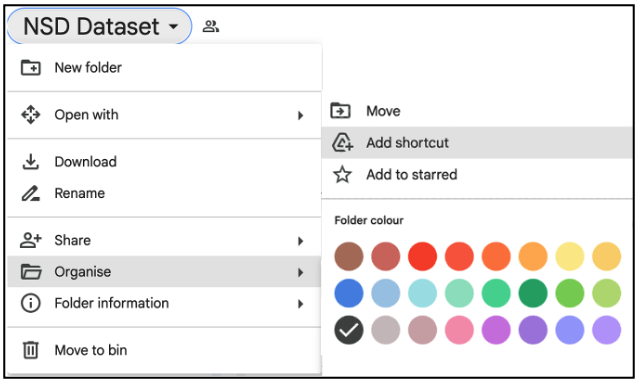

In [2]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)
nsd_dir = '/content/drive/MyDrive/NSD_25_images' #@param {type:"string"}

Mounted at /content/drive/


In [3]:
nsd_fmri = os.path.join(nsd_dir,'NSD_25_fmri')
nsd_stimuli = os.path.join(nsd_dir,'NSD_25_images')
nsd_viz = os.path.join(nsd_dir,'NSD_25_roi_masks')
current_directory = os.getcwd()

## 1.1 | Downloading Locally

To download the dataset locally, we will be using the API from Net2Brain, a toolbox that guides in explaining cortical representations using deep neural networks with a multitude of models and metrics. This toolbox also contains various datasets to directly play with the toolbox, such as former Algonauts Datasets, a Harry Potter dataset which is used in the second part, and this subset of the Algonauts Challenge 2023! To download the data, execute the cell below.


In [3]:
from net2brain.utils.download_datasets import DatasetNSD_25

NSD_dataset = DatasetNSD_25()
NSD_paths = NSD_dataset.load_dataset()

In [ ]:
pprint(NSD_paths)
nsd_fmri = NSD_paths['roi_path']
nsd_stimuli = NSD_paths['stimuli_path']
nsd_viz = NSD_paths['viz_path']
current_directory = os.getcwd()

## 1.2 What did we download?

Each downloaded dataset comes with different files to run experiments. This subset of the NSD Dataset comes with these folders:

* **NSD_25_fmri:** Path to the fMRI data
* **NSD_25_RDMs:** Path to RDMs generated from the fMRI data
* **NSD_25_images:** Path to all the images
* **NSD_25_captions:** Path to all image captions (from COCO)

For the regions of interest within **NSD_25_fmri:** and **NSD_25_RDMs:** we have the following:

* **Early visual regions (prf-visualrois):** V1v, V1d, V2v, V2d, V3v, V3d, hV4.
* **Body-selective regions (floc-bodies):** EBA, FBA-1, FBA-2.
* **Face-selective regions (floc-faces):** OFA, FFA-1, FFA-2.
* **Place-selective regions (floc-places):** OPA, PPA, RSC.

**Questions:**

1. **What is the difference between V1v and V1d?**

   V1v (ventral) and V1d (dorsal) are subdivisions of the primary visual cortex (V1), responsible for processing visual information. V1v processes the lower visual field, while V1d processes the upper visual field. Similarly, V2v and V2d are subdivisions of the secondary visual cortex (V2), and V3v and V3d are subdivisions of the tertiary visual cortex (V3).

2. **Why do some files end with _lh and some with _rh?**

   The suffixes _lh and _rh stand for left hemisphere and right hemisphere, respectively.

3. **Why are the shapes different across subjects?**

   The shapes are different across subjects because the number of voxels (3D pixels representing brain activity) varies depending on individual brain anatomy and the specific regions of interest being measured. The number of activated voxels can differ due to variations in brain size, structure, and the extent of functional areas.

Execute the cells below to go through the data folders!


In [5]:
# Dropdown for selecting category
categories = ['prf-visualrois', 'floc-bodies', 'floc-faces', 'floc-places']
category_dropdown = widgets.Dropdown(
    options=categories,
    value=categories[0],
    description='ROI Class:'
)

# Dropdown for selecting subfolder (initially empty)
subfolder_dropdown = widgets.Dropdown(
    options=[],
    description='ROI:'
)

# Update subfolder options based on initial category
subfolder_dropdown.options = list_subfolders(os.path.join(nsd_fmri, categories[0]))

# Set the update function for category dropdown
category_dropdown.observe(update_subfolder_options, names='value')

# Display dropdowns
display(category_dropdown)
display(subfolder_dropdown)

# Button to trigger the display of selected subfolder contents
button = widgets.Button(description="Show Available Data")
output = widgets.Output()

button.on_click(on_button_clicked)

display(button, output)

Dropdown(description='ROI Class:', options=('prf-visualrois', 'floc-bodies', 'floc-faces', 'floc-places'), val…

Dropdown(description='ROI:', options=('V1d', 'V1v', 'V2d', 'V2v', 'V3d', 'V3v', 'hV4'), value=None)

Button(description='Show Available Data', style=ButtonStyle())

Output()

---
---

# 2 | Getting to know the data before playing with it

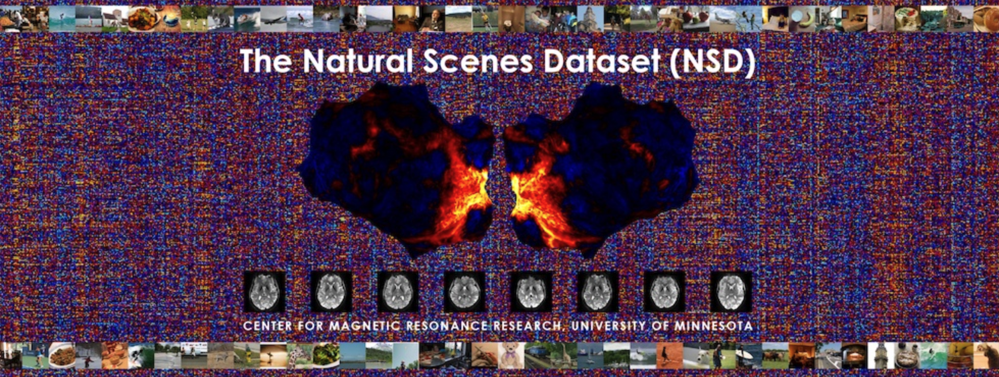

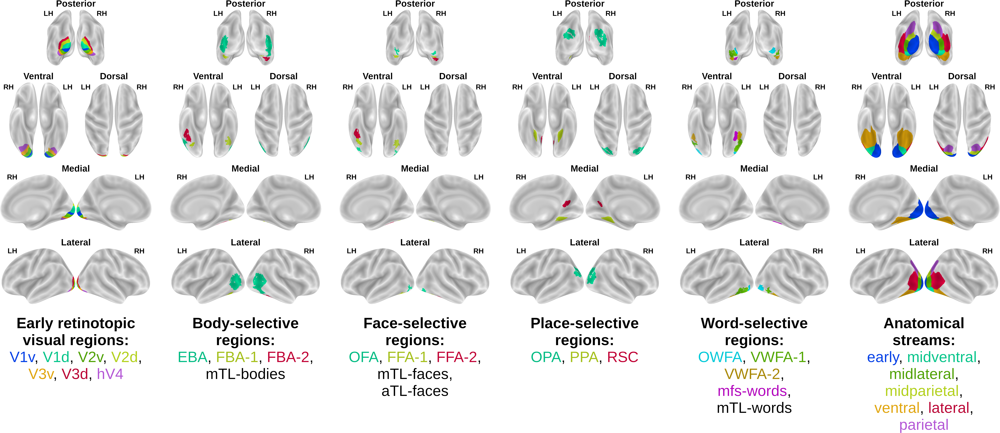

The data for the Algonauts Project 2023 Challenge was derived from the NSD (Natural Scenes Dataset) experiment, which originally included around 10,000 images per subject. For each of the 8 subjects, the fMRI data was recorded as they viewed these images, with responses captured from both the left and right hemispheres of the brain.

To simplify and speed up computations, our analysis focuses on a subset of 25 images that all subjects have seen. This allows us to efficiently compare and process the fMRI responses across all participants.

## 2.1 Visualizing the Distinct Regions Across the Brain

As this is a reduced version of the original Algonauts 2023 challenge, we only provide a subset of the available regions of interest and a subset of the stimuli data.

* **Early visual regions (prf-visualrois):** V1v, V1d, V2v, V2d, V3v, V3d, hV4.
* **Body-selective regions (floc-bodies):** EBA, FBA-1, FBA-2.
* **Face-selective regions (floc-faces):** OFA, FFA-1, FFA-2.
* **Place-selective regions (floc-places):** OPA, PPA, RSC.

Now you will visualize the vertices of a ROI and hemisphere of your choice on a brain surface map.

> For this, you will use the files `*h.*_fsaverage_space.npy`, which give you the brain surface indices (in `fsaverage space`) of several ROIs belonging to a ROI class (e.g., the `prf-visualrois` class), and the files `mapping_*.npy`, which allow you to select your chosen ROI among all ROIs of the ROI class.

Note that not all ROIs exist for all subjects and hemispheres.


In [9]:
import os
import numpy as np
from nilearn import datasets, plotting

# Choose subject
subject = 'subj01' # @param ['subj01', 'subj02', 'subj03', 'subj04', 'subj05', 'subj06', 'subj07', 'subj08'] {allow-input: true}
print(f'Selected Subject: {subject}')

# Choose hemisphere
hemisphere = 'left' # @param ['left', 'right'] {allow-input: true}
print(f'Selected Hemisphere: {hemisphere}')

# Choose ROI
roi = "V1d" # @param ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4", "EBA", "FFA-1", "FFA-2", "OPA", "PPA", "VWFA-1", "VWFA-2"] {allow-input: true}
roi_class = get_roi_class(roi)
print(f'Selected ROI: {roi}')

# Construct the path to the visualization folder for the selected subject
visualization_folder = os.path.join(nsd_viz, subject)

# Load the ROI brain surface maps
roi_class_dir = os.path.join(visualization_folder, f'{hemisphere[0]}h.{roi_class}_fsaverage_space.npy')
roi_map_dir = os.path.join(visualization_folder, f'mapping_{roi_class}.npy')
fsaverage_roi_class = np.load(roi_class_dir)
roi_map = np.load(roi_map_dir, allow_pickle=True).item()

# Select the vertices corresponding to the ROI of interest
roi_mapping = list(roi_map.keys())[list(roi_map.values()).index(roi)]
fsaverage_roi = np.asarray(fsaverage_roi_class == roi_mapping, dtype=int)

# Create the interactive brain surface map
fsaverage = datasets.fetch_surf_fsaverage('fsaverage')
view = plotting.view_surf(
    surf_mesh=fsaverage['infl_' + hemisphere],
    surf_map=fsaverage_roi,
    bg_map=fsaverage['sulc_' + hemisphere],
    threshold=1e-14,
    cmap='cool',
    colorbar=False,
    title=roi + ', ' + hemisphere + ' hemisphere from ' + subject
)
view


Selected Subject: subj01
Selected Hemisphere: left
Selected ROI: V1d


Downloaded 23511040 of 28905506 bytes (81.3%,   17.6s remaining) ...done. (81 seconds, 1 min)
Extracting data from /Users/domenicbersch/nilearn_data/fsaverage/5592d63c5c8039b4f902396c128dcd85/download..... done.


## 2.2 Visualizing some example images

The NSD Dataset contains images from the COCO dataset, which can also come with segmentation masks and captions. These are not included in this experiment but can be downloaded through the Net2Brain API, as explained in the [other tutorials](https://github.com/cvai-roig-lab/Net2Brain/blob/main/notebooks/0_Exploring_Net2Brain.ipynb) and the [documentation](https://net2brain.readthedocs.io/en/latest/datasets.html#).

Execute the cell below to take a look at which images are available in this subset!


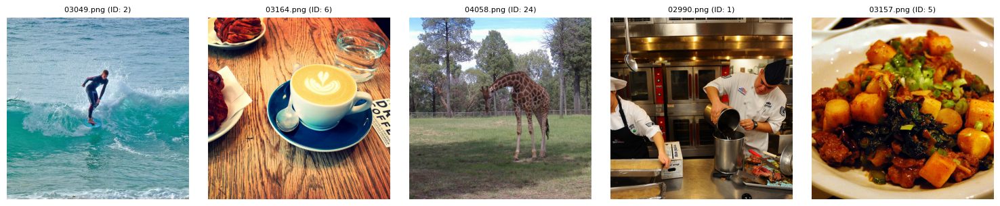

In [10]:
def show_random_images(stimulus_path, num_images=5):
    # List all files in the stimulus_path
    all_files = [f for f in os.listdir(stimulus_path) if os.path.isfile(os.path.join(stimulus_path, f))]
    all_files.sort()  # Sort the files to determine the index

    # Select num_images random files
    random_files = random.sample(all_files, num_images)

    # Set up the plot
    fig, axs = plt.subplots(nrows=(num_images + 4) // 5, ncols=5, figsize=(15, 3 * ((num_images + 4) // 5)))
    axs = axs.flatten()

    for ax, file in zip(axs, random_files):
        img_path = os.path.join(stimulus_path, file)
        img = mpimg.imread(img_path)
        file_index = all_files.index(file)  # Get the index of the file
        ax.imshow(img)
        ax.set_title(f"{file} (ID: {file_index})", fontsize=8)
        ax.axis('off')

    for ax in axs[len(random_files):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()


# Choose number of images to display
num_images = 5 # @param {type:"slider", min:0, max:25, step:1}
show_random_images(nsd_stimuli, num_images)


## 2.3 Visualizing fMRI responses to NSD images on **specific** regions

Selected Subject: subj01
Selected Hemisphere: left
Selected ROI: V1d


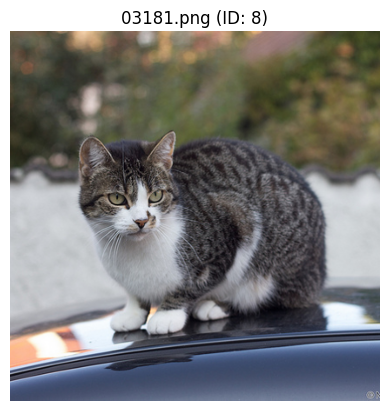

In [11]:
img = 8 #@param {type:"slider", min:0, max:25, step:1}

# Choose subject
subject = 'subj01' # @param ['subj01', 'subj02', 'subj03', 'subj04', 'subj05', 'subj06', 'subj07', 'subj08'] {allow-input: true}
print(f'Selected Subject: {subject}')

# Choose hemisphere
hemisphere = 'left' # @param ['left', 'right'] {allow-input: true}
print(f'Selected Hemisphere: {hemisphere}')

# Choose ROI
roi = "V1d" # @param ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4", "EBA", "FFA-1", "FFA-2", "OPA", "PPA", "VWFA-1", "VWFA-2"] {allow-input: true}
roi_class = get_roi_class(roi)
print(f'Selected ROI: {roi}')

# Construct the path to the visualization folder for the selected subject
visualization_folder = os.path.join(nsd_viz, subject)

# Load the ROI brain surface maps
challenge_roi_class_dir = os.path.join(visualization_folder,
    hemisphere[0]+'h.'+roi_class+'_challenge_space.npy')
fsaverage_roi_class_dir = os.path.join(visualization_folder,
    hemisphere[0]+'h.'+roi_class+'_fsaverage_space.npy')
roi_map_dir = os.path.join(visualization_folder,
    'mapping_'+roi_class+'.npy')
challenge_roi_class = np.load(challenge_roi_class_dir)
fsaverage_roi_class = np.load(fsaverage_roi_class_dir)
roi_map = np.load(roi_map_dir, allow_pickle=True).item()

# Select the vertices corresponding to the ROI of interest
roi_mapping = list(roi_map.keys())[list(roi_map.values()).index(roi)]
challenge_roi = np.asarray(challenge_roi_class == roi_mapping, dtype=int)
fsaverage_roi = np.asarray(fsaverage_roi_class == roi_mapping, dtype=int)


# Load fMRI data for the selected ROI and hemisphere
fmri_data_path = os.path.join(nsd_fmri, roi_class, roi, f"{subject}_roi-{roi}_{hemisphere[0]}h.npy")


my_data = np.load(fmri_data_path, allow_pickle=True)

# Assume that my_image is the data for the first image for demonstration purposes
my_image = my_data[0]

# Initialize the response map
fsaverage_response = np.zeros(len(fsaverage_roi))
fsaverage_response[np.where(fsaverage_roi)[0]] = my_image

# Create the interactive brain surface map
fsaverage = datasets.fetch_surf_fsaverage('fsaverage')
view = plotting.view_surf(
    surf_mesh=fsaverage['infl_'+hemisphere],
    surf_map=fsaverage_response,
    bg_map=fsaverage['sulc_'+hemisphere],
    threshold=1e-14,
    cmap='cold_hot',
    colorbar=True,
    title=roi+', '+hemisphere+' hemisphere from ' + subject
)
display(view)

# Display the selected image from the nsd_stimuli folder
stimulus_path = nsd_stimuli
all_files = [f for f in os.listdir(stimulus_path) if os.path.isfile(os.path.join(stimulus_path, f))]
all_files.sort()  # Sort the files to determine the index
selected_file = all_files[img]

# Display the image
img_path = os.path.join(stimulus_path, selected_file)
img_read = mpimg.imread(img_path)
plt.figure()
plt.imshow(img_read )
plt.axis('off')
plt.title(f"{selected_file} (ID: {img})")
plt.show()

---
---

# 3 | Example Study: Predictive capabiltiies of Deep Neural Networks Models for the Visual Cortex using Linear Encoding on **ResNet50**

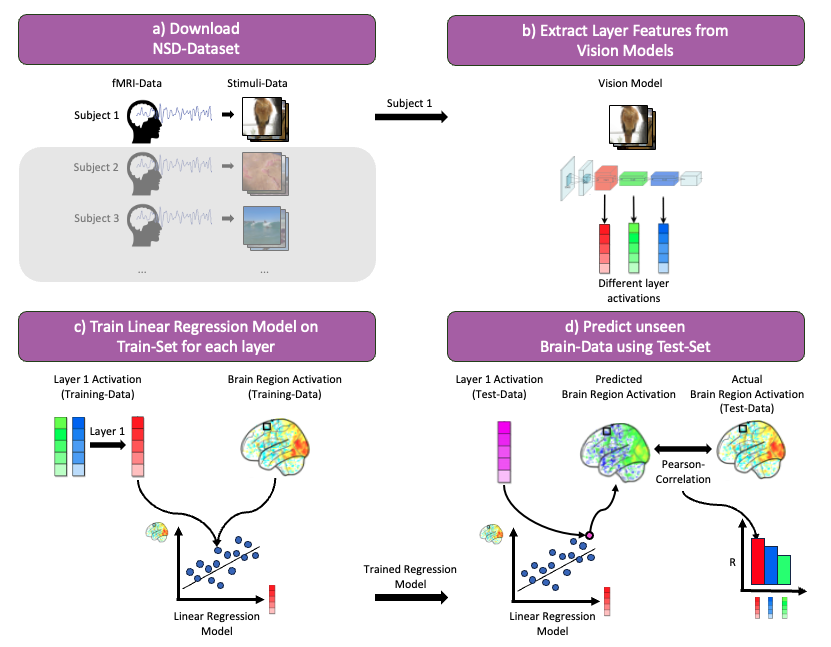

In this step, we use Linear Encoding to compare the activations of **ResNet50** with human fMRI responses to the same images. This method trains a classifier using the model activations to see how well it can predict brain activity it has not seen before. This helps us understand the models' effectiveness in mimicking human brain processes.

* **Step a):** Download NSD-Dataset (already done)
* **Step b):** Extract features from **ResNet50** for the same images that the participants have seen
* **Step c):** For each of the extracted layers, use the model features to train a classifier that predicts the brain data for the same images on a training set
* **Step d):** Now using the held-out test set, use the encoding model to predict what the brain responses would look like to unseen images. Then compute the Pearson correlation between the predicted brain activation and the actual brain activation. This value will be the measure of how well our model is able to predict brain responses.


## **Step a):** Downloading NSD-Dataset

In [ ]:
# Already done at the top of the notebook!

## **Step b):** Extracting Features from ResNet50

In this step, we will extract the intermediate model features of an ImageNet pretrained **ResNet50** model using the toolbox **Net2Brain**. With this toolbox, you can simply select the model name from a netset (model family) to extract the data given input images.


In [12]:
####################################################
# This time we preselect it for you! In the next chapter you can select it yourself
model_name = "ResNet50"
netset = "Standard"
feat_path = 'ResNet_feats'

####################################################


# Extract the features using Net2Brain
from net2brain.feature_extraction import FeatureExtractor

# Loading up the feature extractor
fx = FeatureExtractor(model=model_name,
                      netset=netset,
                      device='cpu')

# Extract features
fx.extract(data_path=nsd_stimuli,
           save_path=feat_path,
           consolidate_per_layer=False)

Processing files: 100%|██████████| 25/25 [00:01<00:00, 22.48it/s, subfiles=1/1]


### How do the files look like?

02990.png
Keys and shapes for features in 02990.png:

Key: layer1
Shape: (1, 256, 56, 56)
Example values: [0.17792608 0.19657502 0.19662791 0.19406284 0.16569602]

Key: layer2
Shape: (1, 512, 28, 28)
Example values: [0.27731583 0.34305292 0.00686936 0.22006898 0.4091112 ]

Key: layer3
Shape: (1, 1024, 14, 14)
Example values: [0.03459723 0.09015048 0.0411621  0.03592029 0.05163018]

Key: layer4
Shape: (1, 2048, 7, 7)
Example values: [0. 0. 0. 0. 0.]


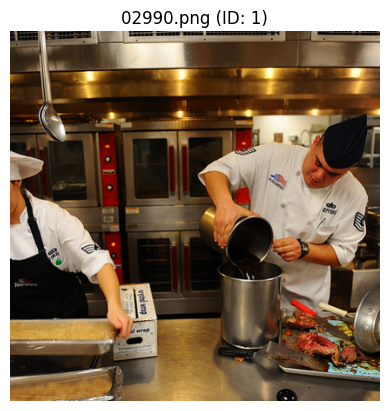

In [13]:
# Slider for selecting image number
img = 1 # @param {type:"slider", min:0, max:25, step:1}

# Display the selected image
all_files = sorted([f for f in os.listdir(nsd_stimuli) if os.path.isfile(os.path.join(nsd_stimuli, f))])
selected_file = all_files[img]
image_name = selected_file.split(".")[0]
img_path = os.path.join(nsd_stimuli, selected_file)
img_data = mpimg.imread(img_path)

print(selected_file)

# Construct the file path for the selected image
feature_file = os.path.join(current_directory,feat_path, f"{image_name}.npz")

# Load the feature file
features = np.load(feature_file, allow_pickle=True)

# Print the keys and their shapes with some example values
print(f"Keys and shapes for features in {image_name}.png:")
for key in features.keys():
    print(f"\nKey: {key}")
    print(f"Shape: {features[key].shape}")
    print(f"Example values: {features[key].ravel()[:5]}")



# Display the image
plt.figure()
plt.imshow(img_data)
plt.axis('off')
plt.title(f"{selected_file} (ID: {img})")
plt.show()

## **Step c) and d):** Training a Linear Classifier and Predicting Brain Responses

**Net2Brain** offers multiple metrics for evaluating model activations against brain responses. In addition to RSA and Variance Partitioning Analysis, it also provides Linear Encoding, which can be called using a single function and has multiple parameters to adapt.

In the following cell, experiment with some of the parameters and observe how the results may change. Each run will be saved in a different file and can be plotted in the subsequent cell.


In [14]:
####################################################

# Choose subject
subject = 'subj01' # @param ['subj01', 'subj02', 'subj03', 'subj04', 'subj05', 'subj06', 'subj07', 'subj08'] {allow-input: true}

# Choose hemisphere
hemisphere = 'right' # @param ['left', 'right'] {allow-input: true}

# Choose ROI
roi = "V2d" # @param ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4", "EBA", "FFA-1", "FFA-2", "OPA", "PPA", "VWFA-1", "VWFA-2"] {allow-input: true}
roi_class = get_roi_class(roi)

# Construct data path
fmri_data_path = os.path.join(nsd_fmri, roi_class, roi, f"{subject}_roi-{roi}_{hemisphere[0]}h.npy")

# Choose Linear Encoding Parameters
n_folds = 3 # @param {type:"slider", min:1, max:10, step:1}
n_components = 8 # @param {type:"slider", min:2, max:25, step:1}
batch_size = 16 # @param {type:"slider", min:1, max:25, step:1}

if n_components > batch_size:
  print("n_components must be smaller than batch_size")

config = f"{n_folds}f_{n_components}c_{batch_size}b"

####################################################


# Start Linear Encoding
from net2brain.evaluations.encoding import Linear_Encoding

Linear_Encoding(
        feat_path = f"/{current_directory}/ResNet_feats",
        roi_path=fmri_data_path,
        model_name=f"{model_name}_{config}",
        trn_tst_split=0.8,
        n_folds=n_folds,
        n_components=n_components,
        batch_size=batch_size,
        random_state=42,
        return_correlations=True,
        save_path=f"Tutorial_LE_Results_single/{subject}",
        file_name=f"{roi}_{hemisphere}_{config}"
    )



100%|██████████| 1/1 [00:08<00:00,  8.07s/it]


,ROI,Layer,Model,R,%R2,Significance,SEM,LNC,UNC
0,subj01_roi-V2d_rh,layer1,ResNet50_3f_8c_16b,0.137905,0.019018,0.347987,0.113395,NaN,NaN
1,subj01_roi-V2d_rh,layer2,ResNet50_3f_8c_16b,0.095694,0.009157,0.383497,0.086418,NaN,NaN
2,subj01_roi-V2d_rh,layer3,ResNet50_3f_8c_16b,0.133359,0.017785,0.048121,0.030361,NaN,NaN
3,subj01_roi-V2d_rh,layer4,ResNet50_3f_8c_16b,0.155496,0.024179,0.132893,0.063164,NaN,NaN


## Visualizing results

Feel free to try out multiple above parameters before plotting!

In [ ]:
####################################################

subject = 'subj01' # @param ['subj01', 'subj02', 'subj03', 'subj04', 'subj05', 'subj06', 'subj07', 'subj08'] {allow-input: true}
dataframes = load_csv_files_from_folder(f"Tutorial_LE_Results_single/{subject}")

####################################################

# Plotting using Net2Brain
from net2brain.evaluations.plotting import Plotting

plotter = Plotting(dataframes)
results_dataframe = plotter.plot_all_layers(metric="R", columns_per_row=4, simplified_legend=True, rotation=30)


# 4 | Automating the example study for **multiple models and rois**

# Extracting Features from models

In this section you can select multiple models from model families from Net2Brain to generate the features from and compare. Some models are larger and some are smaller - we would therefore propose the following models, but feel free to try any model:


* AlexNet - Standard
* ResNet18 - Standard
* ResNet50 - Standard
* VGG16 - Standard
* RN50 - Clip
* ViT-B/32 - Clip
* vit_base_patch16_224 - Timm
* Any model you like!



## Feature Extraction

Execute the cell to have a dropdown appear where you can select any model you like!

In [ ]:
# Function to execute feature extraction with Net2Bran
from net2brain.feature_extraction import FeatureExtractor

def execute_feature_extraction(device, netset, model):
    fx = FeatureExtractor(model=model,
                          netset=netset,
                          device=device)

    folder = model.replace("/", "_")
    fx.extract(data_path=nsd_stimuli,
               save_path=f"{folder}_feats",
               consolidate_per_layer=False)
    print("")
    print(f"Feature extraction completed for model: {model}, netset: {netset}, device: {device}")



####################################################

# Create and display widgets for feature extraction
create_feature_extraction_widgets()

# Initial population of models
update_models(None)


## Automated Linear Encoding

Execute the cell to see dropdowns to execute multiple instances of Linear Encoding!

**Hint:** You can select **multiple** elements by pressing Strg/Command

In [ ]:
# Start Linear Encoding
from net2brain.evaluations.encoding import Linear_Encoding

# Function to run linear encoding
def run_linear_encoding(models, subjects, hemispheres, rois, n_folds, n_components, batch_size):
    if n_components >= batch_size:
        print("n_components must be smaller than batch_size")
        return

    for subject in subjects:
        for hemisphere in hemispheres:
            for roi in rois:
                roi_class = get_roi_class(roi)
                fmri_data_path = os.path.join(nsd_fmri, roi_class, roi, f"{subject}_roi-{roi}_{hemisphere[0]}h.npy")

                config = f"{n_folds}f_{n_components}c_{batch_size}b"

                for model in models:
                    model_name = model + '_feats'

                    Linear_Encoding(
                        feat_path=os.path.join(current_directory, model_name),
                        roi_path=fmri_data_path,
                        model_name=f"{model_name}_{config}",
                        trn_tst_split=0.8,
                        n_folds=n_folds,
                        n_components=n_components,
                        batch_size=batch_size,
                        random_state=42,
                        return_correlations=True,
                        save_path=f"Tutorial_LE_Results/{subject}",
                        file_name=f"{model_name}_{roi}_{hemisphere}_{config}"
                    )

                    print(f"Finsihed running Linear Encoding for subject={subject}, hemisphere={hemisphere}, roi={roi}, model={model_name}")

# Create and display widgets for linear encoding
create_linear_encoding_widgets()


# 5 | Plotting

In [ ]:
from net2brain.evaluations.plotting import Plotting

subject = 'subj01' # @param ['subj01', 'subj02', 'subj03', 'subj04', 'subj05', 'subj06', 'subj07', 'subj08'] {allow-input: true}

dataframes = load_csv_files_from_folder(f"Tutorial_LE_Results/{subject}")

plotter = Plotting(dataframes)
results_dataframe = plotter.plot(metric="R", rotation=30)
print(results_dataframe)